# Machine Learning: Breast Cancer Wisconsin

## 1. Data Exploration

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import pickle
import time
import statsmodels.api as sm

from datetime import datetime
from matplotlib.pyplot import figure
from sklearn.preprocessing import StandardScaler, scale
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import GridSearchCV, PredefinedSplit
from sklearn.neighbors import NearestCentroid, KNeighborsClassifier
from sklearn.ensemble import StackingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from numpy import arange

warnings.filterwarnings('ignore')
%matplotlib inline

# This function calculates the prevalence of the positive class (label = 1)
def calc_prevalence(y_actual):
    return (sum(y_actual)/len(y_actual))

# Calculates specificity
def calc_specificity(actual, predicted):
    cm = confusion_matrix(actual, predicted)
    TN = cm[0,0] 
    FP = cm[0,1]
    return TN/(TN+FP)

def print_report(actual, predicted):
    
    accuracy = accuracy_score(actual, predicted)
    recall = recall_score(actual, predicted)
    precision = precision_score(actual, predicted)
    specificity = calc_specificity(actual, predicted)
    f1 = 2 * (precision * recall) / (precision + recall)
   
    print('accuracy:    %.4f'%accuracy)
    print('recall:      %.4f'%recall)
    print('precision:   %.4f'%precision)
    print('specificity: %.4f'%specificity)
    print('prevalence:  %.4f'%calc_prevalence(actual))
    print('f1:          %.4f'%f1)
    print(' ')
    return auc, accuracy, recall, precision, specificity, f1

# create empty list for results and then save test results in these lists
model_list = []
accuracy_list = []
recall_list = []
precision_list = []
specificity_list = []
f1_list = []

def saveresults(actual, predicted, model = 'String_Value'):
    if model in model_list:
        print('There already exists an entry for this model.\nPlease change the model name!')
    else:
        accuracy = accuracy_score(actual, predicted)
        recall = recall_score(actual, predicted)
        precision = precision_score(actual, predicted)
        specificity = calc_specificity(actual, predicted)
        f1 = 2 * (precision * recall) / (precision + recall)


        model_list.append(model)
        accuracy_list.append(accuracy)
        recall_list.append(recall)
        precision_list.append(precision)
        specificity_list.append(specificity)
        f1_list.append(f1)
        print('Values saved successfully for',model)
    
# Creates an empty List with "nans"
def nans(shape, dtype = float):
    a = np.empty(shape, dtype)
    a.fill(np.nan)
    return a

# Create a COnfusion Matrix
def cm(actual, predicted):
    cm = confusion_matrix(actual, predicted)
    
    fig, ax = plt.subplots(figsize=(4, 4))
    ax.imshow(cm)
    ax.grid(False)
    ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
    ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))
    ax.xaxis.tick_top()
    ax.set_ylim(1.5, -0.5)
    for i in range(2):
        for j in range(2):
            ax.text(j, i, cm[i, j], ha='center', va='center', color='red')
    plt.show()
    
df = pd.read_csv('wdbc.csv')

df['diagnosis'] = (df['Diagnosis'] == 'M').astype('int')
df = df.drop(axis=1, columns = 'Diagnosis')
df = df.drop(axis=1, columns = 'ID')

columns = df.columns.tolist()
columns = columns[-1:] + columns[:-1]
col_mean = columns[:10]
col_se = ['diagnosis'] + columns[10:20]
col_worst = ['diagnosis'] + columns[20:30]

df_mean = df[col_mean]
df_se = df[col_se]
df_worst = df[col_worst]

print(datetime.now())

2022-01-08 11:43:19.706832


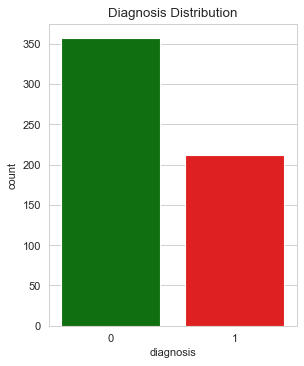

In [2]:
#Visualize this count
sns.set_style('whitegrid')
figure(figsize=(4, 5), dpi = 80)
plt.title('Diagnosis Distribution')
sns.countplot(x = df['diagnosis'],label="Count", palette = ('g','r'))
plt.savefig('Diagnosis_distribution.png', dpi = 500, transparent = True)
plt.show()

## 2. Feature Engineering

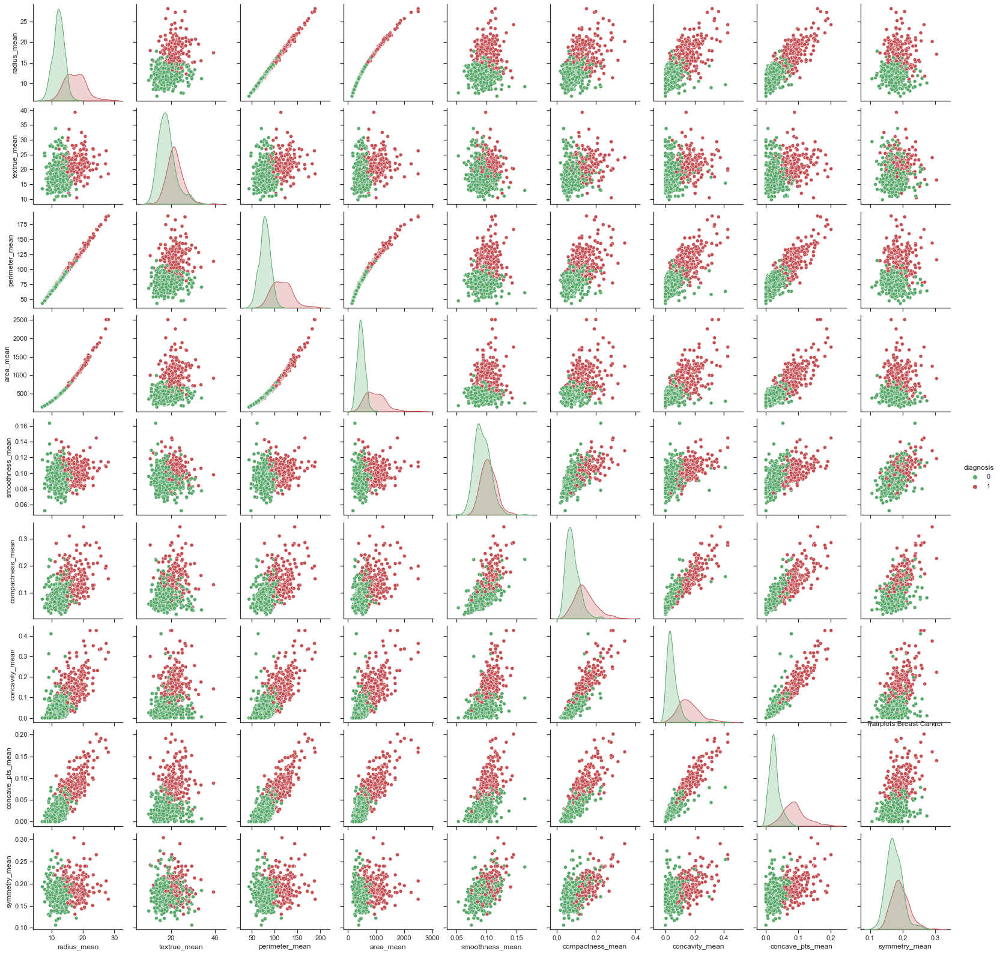

In [3]:
sns.set(style = 'ticks')
sns.pairplot(df_mean, hue = 'diagnosis', palette = ('g','r'))
plt.title('Pairplots Breast Cancer')
plt.savefig('Pairplot_mean.jpg', dpi = 500)
plt.show()

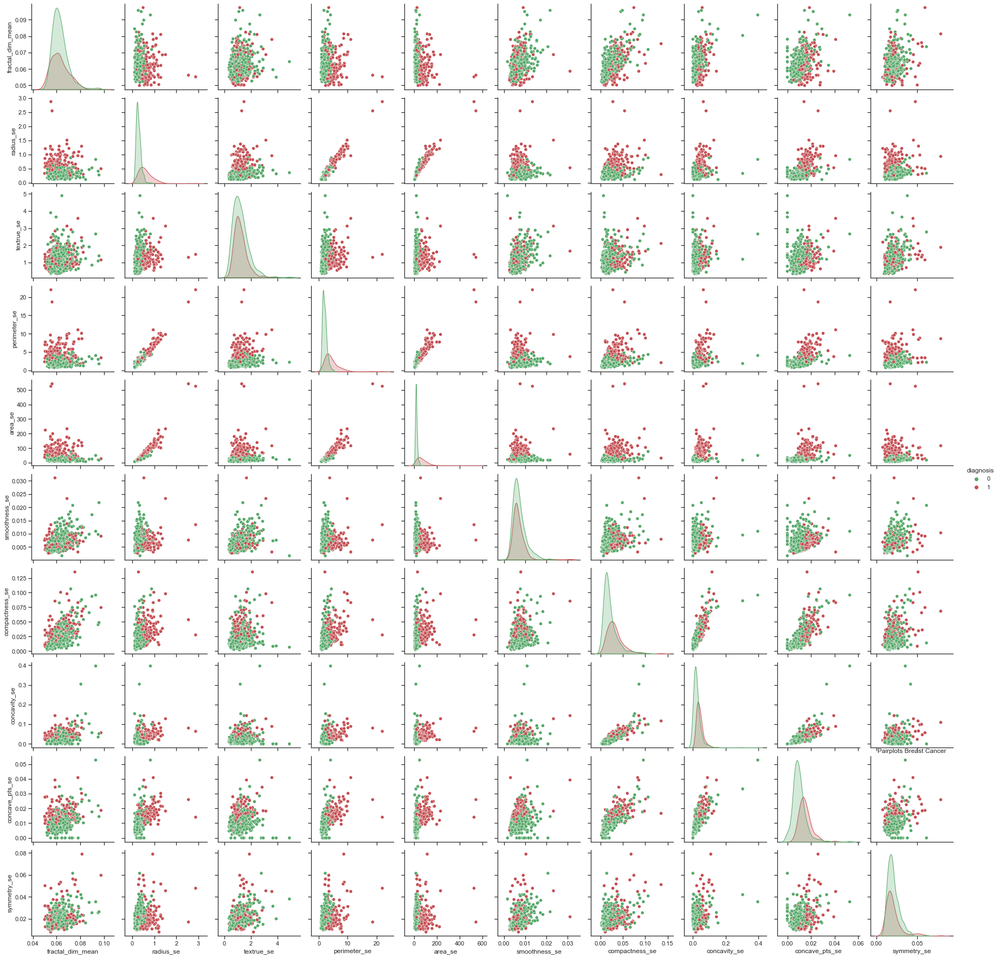

In [4]:
sns.set(style = 'ticks')
sns.pairplot(df_se, hue = 'diagnosis', palette = ('g','r'))
plt.title('Pairplots Breast Cancer')
plt.savefig('Pairplot_se.jpg', dpi = 500)
plt.show()

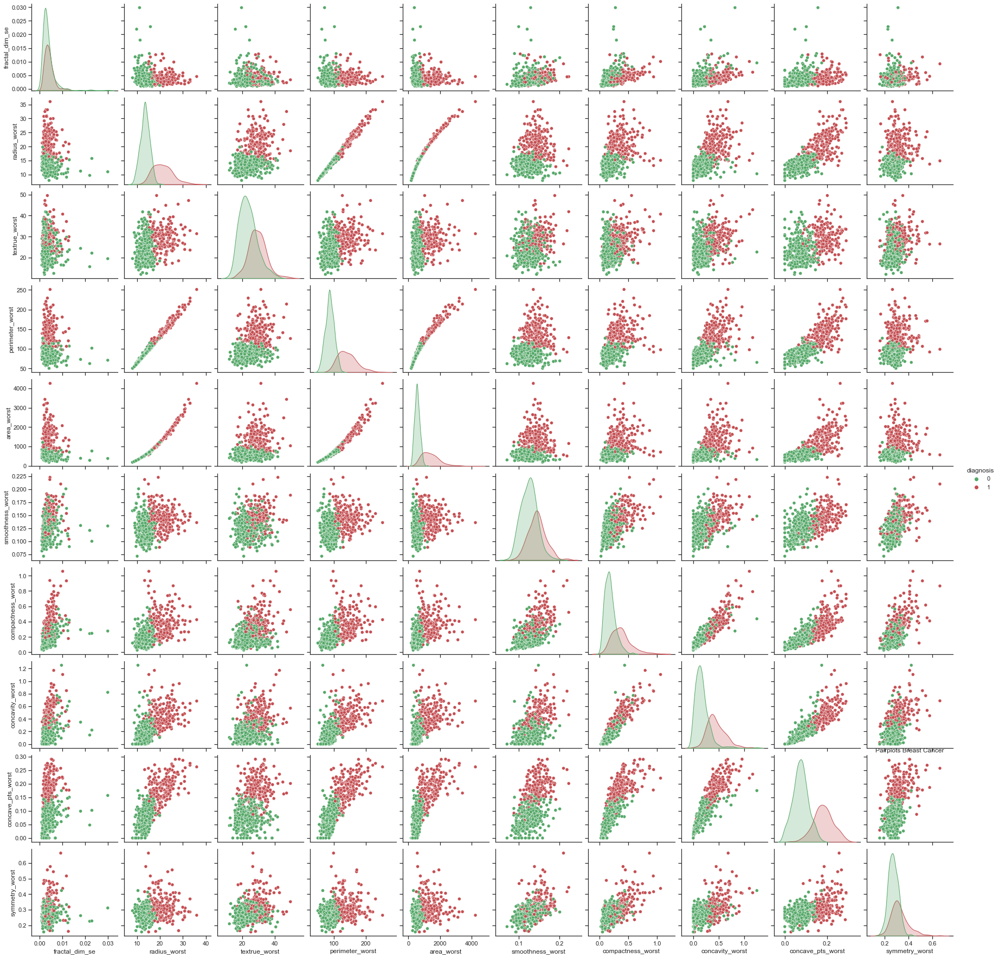

In [5]:
sns.set(style = 'ticks')
sns.pairplot(df_worst, hue = 'diagnosis', palette = ('g','r'))
plt.title('Pairplots Breast Cancer')
plt.savefig('Pairplot_worst.jpg', dpi = 500)
plt.show()

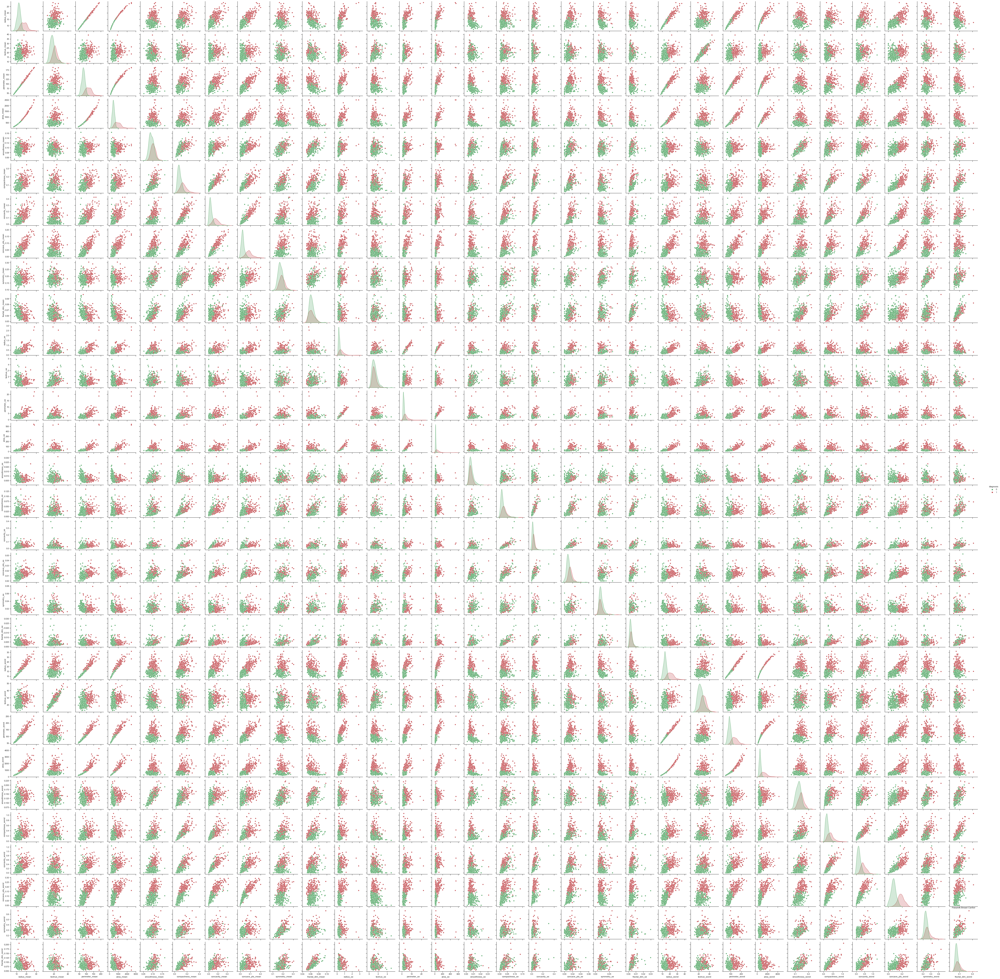

In [6]:
sns.set(style = 'ticks')
sns.pairplot(df, hue = 'diagnosis', palette = ('g','r'))
plt.title('Pairplots Breast Cancer')
#plt.savefig('Scatterplot_all.png')
plt.show()

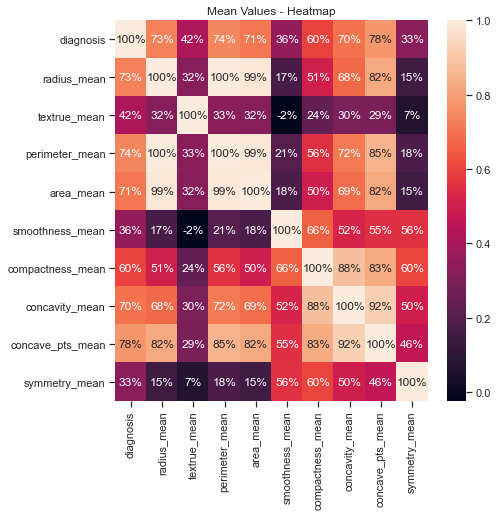

In [7]:
figure(figsize=(7,7))
sns.heatmap(df_mean.corr(),annot=True, fmt = '.0%').set(title = "Mean Values - Heatmap")
plt.savefig('Heatmap_mean.jpg', dpi = 500, bbox_inches="tight")

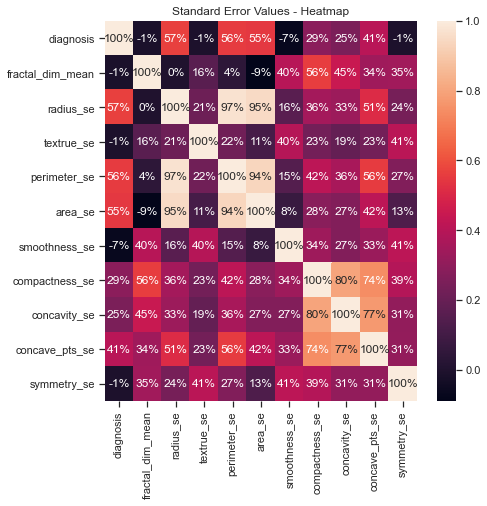

In [8]:
figure(figsize=(7,7))
sns.heatmap(df_se.corr(),annot=True, fmt = '.0%').set(title = "Standard Error Values - Heatmap")
plt.savefig('Heatmap_se.jpg', dpi = 500, bbox_inches="tight")

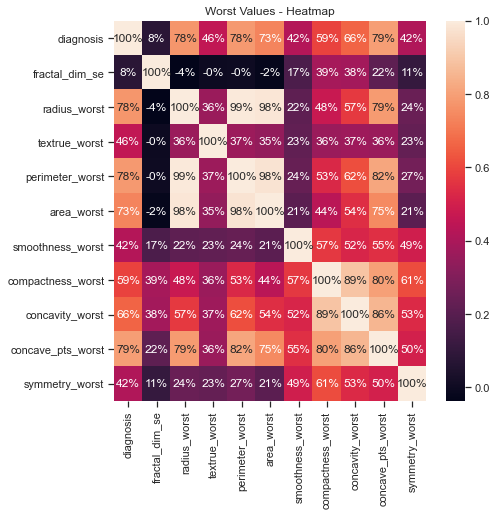

In [9]:
figure(figsize=(7,7))
sns.heatmap(df_worst.corr(),annot=True, fmt = '.0%').set(title = "Worst Values - Heatmap")
plt.savefig('Heatmap_worst.jpg', dpi = 500, bbox_inches="tight")

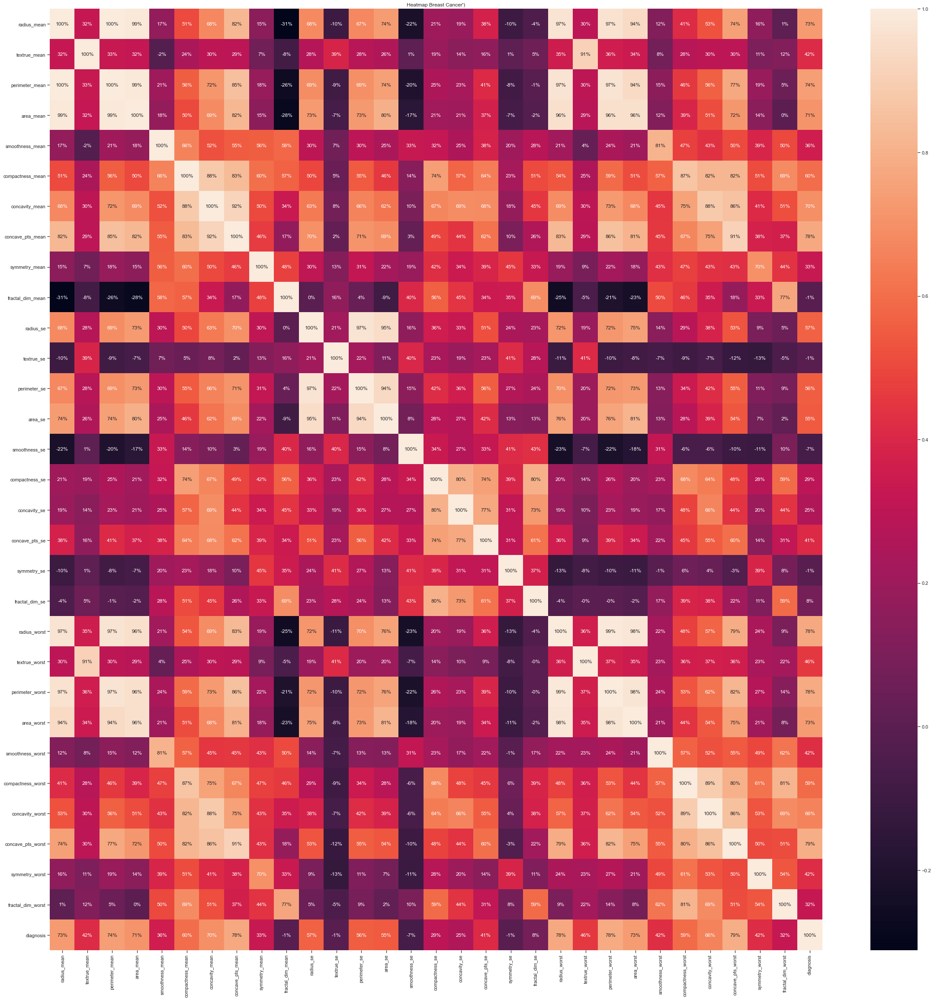

In [10]:
figure(figsize=(40,40))
sns.heatmap(df.corr(),annot=True, fmt = '.0%').set(title = "Heatmap Breast Cancer')")
#plt.savefig('Heatmap_all.png')
plt.show()

## 3. Building Training, Validation & Test Samples

In [3]:
# shuffle the samples
df_data = df.sample(n = len(df), random_state = 320)

# 80% for the validation and training samples together
df_valid_train = df_data.sample(frac = 8/10,random_state = 320)

# Split into validation samples by 10% and training samples by 80%
df_train = df_valid_train.sample(frac = 7/8, random_state = 320)
#print('Split size Train:     ',round((len(df_train)/len(df_data)),2))

df_valid = df_valid_train.drop(df_train.index)
#print('Split size Validation:',round((len(df_valid)/len(df_data)),2))

# Use the rest of the data as test data
df_test = df_data.drop(df_valid_train.index)
#print('Split size Test:      ',round((len(df_test)/len(df_data)),2))

# All three dataframes are saved into csv and the cols_input
df_train.to_csv('df_train.csv',index=False)
df_valid.to_csv('df_valid.csv',index=False)
df_test.to_csv('df_test.csv',index=False)

# Create the X and y matrices
X_train = df_train[columns[1:31]].values
X_valid = df_valid[columns[1:31]].values
X_test = df_test[columns[1:31]].values
X_valid_train = df_valid_train[columns[1:31]].values

y_train = df_train['diagnosis'].values
y_valid = df_valid['diagnosis'].values
y_test = df_test['diagnosis'].values
y_valid_train = df_valid_train['diagnosis'].values

# Create a scalar, save it, and scale the X matrices
scaler  = StandardScaler()
scaler.fit(X_train)

scalerfile = 'scaler.sav'
pickle.dump(scaler, open(scalerfile, 'wb'))

# Load it back
scaler = pickle.load(open(scalerfile, 'rb'))

# Transform our data matrices
X_train_tf = scaler.transform(X_train)
X_valid_tf = scaler.transform(X_valid)
X_test_tf = scaler.transform(X_test)
X_valid_train_tf = scaler.transform(X_valid_train)

## 4. Model Selection

### Gauss Naive Bayes

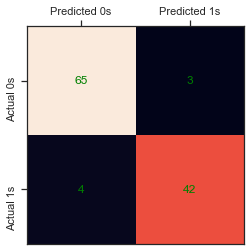

In [12]:
# define the model
gnb = GaussianNB()

# train the model
gnb.fit(X_train, y_train)

# predict Test results
y_pred = gnb.predict(X_test) 


cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('GNB.jpg', dpi = 500)
plt.show()

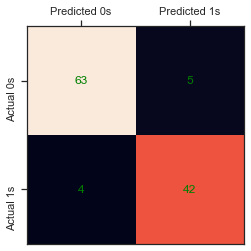

In [13]:
# define the model
gnb = GaussianNB()

# train the model
gnb.fit(X_train_tf, y_train)

# predict Test results
y_pred = gnb.predict(X_test_tf) 

cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('GNB_tf.jpg', dpi = 500)
plt.show()

### Nearest neighbor method (KNN)

#### Nearest Neighbors Classification (NNC)

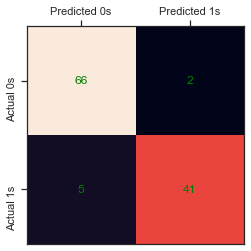

In [14]:
# default K
K = 5

neigh = KNeighborsClassifier(n_neighbors = K, p = 2)

neigh.fit(X_train_tf, y_train)

y_pred = neigh.predict(X_test_tf) 

cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('KNN_NNC_default.jpg', dpi = 500)
plt.show()

In [4]:
K_param = list(range(2,60))

# Define a list in which we write the accuracies
acc_valid_K = []

size = len(K_param)+1
column_names = ['K','Corr_Pred','Samp_size', 'Accuracy']
table_empty = nans([size, 4])

table_valid = pd.DataFrame(table_empty, columns = column_names)
table_valid[table_valid.index.notnull()]


for K in K_param:
    k = K-1
    neigh_K = KNeighborsClassifier(n_neighbors=K,p=2)
    neigh_K.fit(X_train_tf, y_train)
    pred_valid = neigh_K.predict(X_valid_tf)
    correct_pred_valid = pred_valid == y_valid    
    table_valid.iloc[k,0] = int(K)
    table_valid.iloc[k,2] = len(y_valid)    
    table_valid.iloc[k,1] = num_correct_pred_valid = np.sum(correct_pred_valid)
    table_valid.iloc[k,3] = accuracy_valid = 100*num_correct_pred_valid/len(y_valid)
    acc_valid_K.append(accuracy_valid) 

table_valid = table_valid.iloc[1: , :]
table_valid.K = table_valid.K.astype(int)
table_valid.Corr_Pred = table_valid.Corr_Pred.astype(int)
table_valid.Samp_size = table_valid.Samp_size.astype(int)    


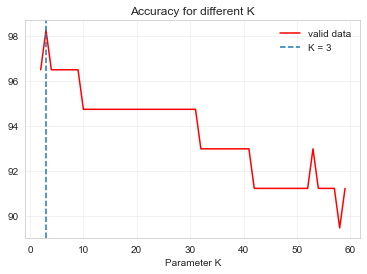

In [5]:
# Plot of accuracy
plt.title('Accuracy for different K')


plt.xlabel('Parameter K')
plt.plot(K_param,acc_valid_K, color = 'red', label = "valid data")

plt.axvline(x = 3, label = 'K = 3', linestyle = '--')
plt.grid(alpha = 0.3)
legend = plt.legend(fancybox=True, framealpha=0)


plt.savefig('KNN_NNC_tuning.png', dpi = 500, transparent = True)
plt.show()

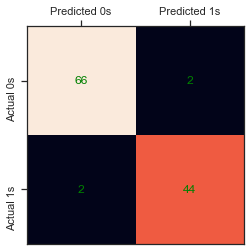

In [18]:
# Test

K = 3

neigh = KNeighborsClassifier(n_neighbors=K,p=2)

neigh.fit(X_train_tf, y_train)

y_pred = neigh.predict(X_test_tf) 

cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('KNN_NNC_tuned.jpg', dpi = 500)
plt.show()

#### Nearest Centroid Classifier (NCC)

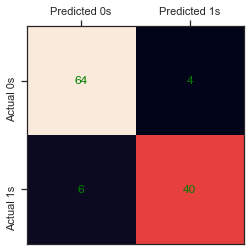

In [19]:
# default Shrinkage
clf = NearestCentroid()
clf.fit(X_train_tf, y_train)

y_pred = clf.predict(X_test_tf)

cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('KNN_NCC_default.jpg', dpi = 500)
plt.show()

In [20]:
# Define a list in which we write the accuracies
acc_valid_K = []

Shrink_Threshold = arange(-60, 15, 1)
NCC_list = list(range(0,len(Shrink_Threshold)))

size = len(NCC_list)+1
column_names = ['K','Corr_Pred','Samp_size', 'Accuracy']
table_empty = nans([size, 4])

table_valid = pd.DataFrame(table_empty, columns = column_names)
table_valid[table_valid.index.notnull()]


for i in NCC_list:
    clf = NearestCentroid(metric = 'euclidean', shrink_threshold = Shrink_Threshold[i])
    clf.fit(X_train_tf, y_train)

    y_pred = clf.predict(X_valid_tf)


    pred_valid = clf.predict(X_valid_tf)
    correct_pred_valid = pred_valid == y_valid    
    table_valid.iloc[i,0] = Shrink_Threshold[i]
    table_valid.iloc[i,2] = len(y_valid)    
    table_valid.iloc[i,1] = num_correct_pred_valid = np.sum(correct_pred_valid)
    table_valid.iloc[i,3] = accuracy_valid = 100*num_correct_pred_valid/len(y_valid)
    acc_valid_K.append(accuracy_valid) 
table_valid = table_valid.iloc[1: , :]

#print('Results Validation Set')
#table_valid.style.apply(highlight_max, color='#F7D358', axis=0)    

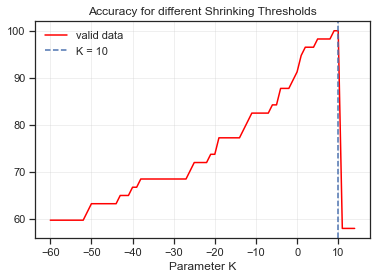

In [21]:
# Plot of accuracy
plt.title('Accuracy for different Shrinking Thresholds')

plt.xlabel('Parameter K')
plt.plot(Shrink_Threshold, acc_valid_K, color = 'red', label="valid data")

plt.axvline(x = 10, label = 'K = 10', linestyle = '--')

plt.grid(alpha = 0.3)
legend = plt.legend(fancybox=True, framealpha=0)


plt.savefig('KNN_NCC_tuning.png', dpi = 500, transparent = True)
plt.show()

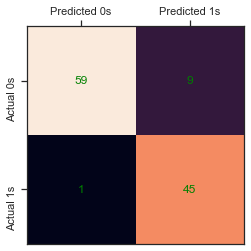

In [22]:
# Test

clf = NearestCentroid(shrink_threshold = 10)
clf.fit(X_train_tf, y_train)

y_pred = clf.predict(X_test_tf)

cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('KNN_NCC_tuned.jpg', dpi = 500)
plt.show()

### Support Vector Machine

#### Linear

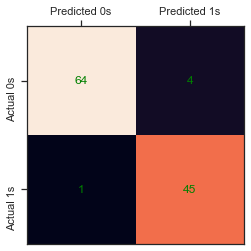

In [23]:
clf = SVC(kernel='linear')

# Fitting data to the classifier
clf.fit(X_train_tf, y_train)

y_pred = clf.predict(X_test_tf)

cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('SVC_lin_default.jpg', dpi = 500)
plt.show()

#### Polynomial

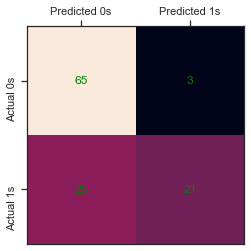

In [24]:
clf = SVC(kernel='poly', degree = 30)

# Fiting data to the classifier
# For now we will not split datast into train/test sets
clf.fit(X_train_tf, y_train)

y_pred = clf.predict(X_test_tf)

cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('SVC_poly_default.jpg', dpi = 500)
plt.show()

#### RBF

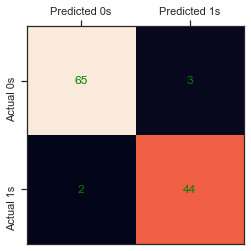

In [25]:
clf = SVC(kernel='rbf')

# Fiting data to the classifier
clf.fit(X_train_tf, y_train)

y_pred = clf.predict(X_test_tf)

cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('SVC_rbf_default.jpg', dpi = 500)
plt.show()

#### Find C penalty

In [26]:
C_param = [0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000]
gamma_param = [0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 10, 100]
#degree_param = [20,30]#[2,5,10,20,30]
cache = 12000

# measure the time needed for the calculations
tic = time.perf_counter()

# defining parameter range
param_grid = {'C': C_param,
              'gamma': gamma_param,
              'kernel': ['linear','rbf']}

# defining the correct train / valid split
split_index = [0 if x in df_valid.index else -1 for x in df_valid_train.index]
pds = PredefinedSplit(test_fold = split_index)

# applying parameters to SVC
grid_all = GridSearchCV(SVC(cache_size = cache), param_grid, scoring = 'f1', cv = pds, verbose = 1)
 
# fitting the model for grid search
grid_all.fit(X_valid_train_tf, y_valid_train)

# print best parameter after tuning
print('\n\033[1mBest Parameters after tuning:\033[0m')
print(grid_all.best_params_)
 
# print how our model looks after hyper-parameter tuning
print('\n\033[1mBest score after hyper-parameter tuning:\033[0m')
print(grid_all.best_score_)

toc = time.perf_counter()
print('\n\033[1mTime needed for calculations:\n\033[0m', round(toc-tic,0),'Seconds')

Fitting 1 folds for each of 128 candidates, totalling 128 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



Best Parameters after tuning:
{'C': 0.1, 'gamma': 1e-05, 'kernel': 'linear'}

Best score after hyper-parameter tuning:
1.0

Time needed for calculations:
 2.0 Seconds


[Parallel(n_jobs=1)]: Done 128 out of 128 | elapsed:    1.7s finished


In [27]:
C_param = [0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000]
degree_param = [2,5,10,20,30]
cache = 12000

# measure the time needed for the calculations
tic = time.perf_counter()

# defining parameter range
param_grid = {'C': C_param,
              'degree': degree_param,
              'kernel': ['poly']}

# defining the correct train / valid split
split_index = [0 if x in df_valid.index else -1 for x in df_valid_train.index]
pds = PredefinedSplit(test_fold = split_index)

# applying parameters to SVC
grid_all = GridSearchCV(SVC(cache_size = cache), param_grid, scoring = 'f1', cv = pds, verbose = 1)
 
# fitting the model for grid search
grid_all.fit(X_valid_train_tf, y_valid_train)

# print best parameter after tuning
print('\n\033[1mBest Parameters after tuning:\033[0m')
print(grid_all.best_params_)
 
# print how our model looks after hyper-parameter tuning
print('\n\033[1mBest score after hyper-parameter tuning:\033[0m')
print(grid_all.best_score_)

toc = time.perf_counter()
print('\n\033[1mTime needed for calculations:\n\033[0m', round(toc-tic,0),'Seconds')

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 1 folds for each of 40 candidates, totalling 40 fits

Best Parameters after tuning:
{'C': 10000, 'degree': 5, 'kernel': 'poly'}

Best score after hyper-parameter tuning:
0.888888888888889

Time needed for calculations:
 1.0 Seconds


[Parallel(n_jobs=1)]: Done  40 out of  40 | elapsed:    0.7s finished


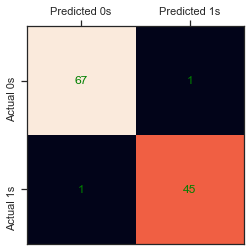

In [28]:
clf = SVC(kernel='linear', C = 0.1)

# Fitting data to the classifier
clf.fit(X_train_tf, y_train)

y_pred = clf.predict(X_test_tf)

cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('SVC_tuned.jpg', dpi = 500)
plt.show()

## Stacking

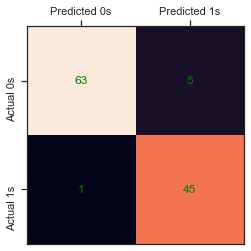

In [29]:
# all best models with preprocessed data

estimators = [
    ('gnb', GaussianNB()),
    ('KNN', KNeighborsClassifier(n_neighbors=3)),
    ('SVM',SVC(kernel='linear', C = 0.1))
    ]
    
clf = StackingClassifier(estimators=estimators)

clf.fit(X_train_tf, y_train)

y_pred = clf.predict(X_test_tf)

cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('Stacking_gnb.jpg', dpi = 500)
plt.show()

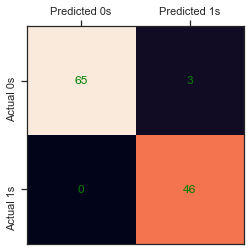

In [30]:
# all best models with preprocessed data

estimators = [
    ('KNN', KNeighborsClassifier(n_neighbors=3,p=2)),
    ('SVM',SVC(kernel='linear', C = 0.1))
    ]
    
clf = StackingClassifier(estimators=estimators)

clf.fit(X_train_tf, y_train)

y_pred = clf.predict(X_test_tf)

cm = confusion_matrix(y_test, y_pred)
   
fig, ax = plt.subplots(figsize=(4, 4))
ax.imshow(cm)
ax.grid(False)
ax.xaxis.set(ticks=(0,1), ticklabels=('Predicted 0s', 'Predicted 1s'))
ax.yaxis.set(ticks=(0,1), ticklabels=('Actual 0s', 'Actual 1s'))

ax.xaxis.tick_top()
ax.set_ylim(1.5, -0.5)
for i in range(2):
    for j in range(2):
        ax.text(j, i, cm[i, j], ha='center', va='center', color='green')
plt.yticks(rotation = 90)
plt.savefig('Stacking.jpg', dpi = 500)
plt.show()

# Graphics Paper

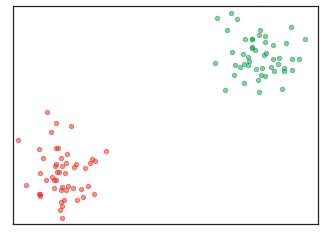

In [31]:
from sklearn.datasets import make_blobs
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

H = 26

X, y = make_blobs(n_samples = 100, centers = 2, n_features = 2, \
              cluster_std = 1,random_state = H)# center_box=(0, 5), )

# scatter plot, dots colored by class value
df = pd.DataFrame(dict(x=X[:,0], y=X[:,1], label=y))
colors = {0:'#d73027', 1:'#1a9850', 2:'yellow'}
fig, ax = plt.subplots()
grouped = df.groupby('label')
ax.set_xlim((-6, 8))
ax.set_ylim((-2, 8))
ax.set_aspect('equal', adjustable='box')
for key, group in grouped:
    group.plot(ax=ax, kind='scatter', x='x', y='y', color = colors[key], alpha = 0.5)

ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)

plt.savefig('KNN_leer.png', dpi = 500, transparent = True)
plt.show()

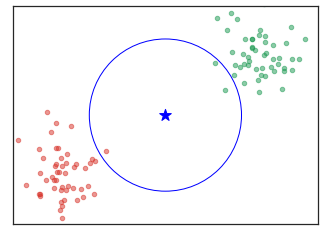

In [32]:
from sklearn.datasets import make_blobs
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

H = 26

X, y = make_blobs(n_samples = 100, centers = 2, n_features = 2, \
              cluster_std = 1,random_state = H)

# scatter plot, dots colored by class value
df = pd.DataFrame(dict(x=X[:,0], y=X[:,1], label=y))
colors = {0:'#d73027', 1:'#1a9850', 2:'yellow'}
fig, ax = plt.subplots()
grouped = df.groupby('label')
ax.set_xlim((-6, 8))
ax.set_ylim((-2, 8))
ax.set_aspect('equal', adjustable='box')
for key, group in grouped:
    group.plot(ax=ax, kind='scatter', x='x', y='y', color = colors[key], alpha = 0.5)
plt.scatter(1, 3, marker = '*', c = 'blue', s = 150)
#plt.scatter(1, 3, marker = '*', c = 'yellow', s = 30)
circle1 = plt.Circle((1, 3), radius = 3.5, color='blue', fill=False)
ax.add_patch(circle1)

ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)

#plt.xlabel("x1")
#plt.ylabel("x2")

plt.savefig('KNN_Kreis.png', dpi = 500, transparent = True)
plt.show()

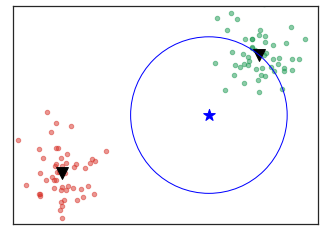

In [33]:
from sklearn.datasets import make_blobs
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.cluster import KMeans

# We set K =5
K = 5 

H = 26

X, y = make_blobs(n_samples = 100, centers = 2, n_features = 2, \
              cluster_std = 1,random_state = H)

kmeans = KMeans(n_clusters=2, random_state=K).fit(X)

centroids = kmeans.cluster_centers_


# scatter plot, dots colored by class value
df = pd.DataFrame(dict(x=X[:,0], y=X[:,1], label=y))
colors = {0:'#d73027', 1:'#1a9850', 2:'yellow'}
fig, ax = plt.subplots()
grouped = df.groupby('label')
ax.set_xlim((-6, 8))
ax.set_ylim((-2, 8))
ax.set_aspect('equal', adjustable='box')
for key, group in grouped:
    group.plot(ax=ax, kind='scatter', x='x', y='y', color = colors[key], alpha = 0.5)
plt.scatter(3, 3, marker = '*', c = 'blue', s = 150)
#plt.scatter(1, 3, marker = '*', c = 'yellow', s = 30)
circle1 = plt.Circle((3, 3), radius = 3.6, color='blue', fill=False)
ax.add_patch(circle1)

ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
ax.scatter(centroids[:, 0], centroids[:, 1], s=140, marker="v", color = "black")

#plt.xlabel("x1")
#plt.ylabel("x2")

plt.savefig('KNN_Dreieck.png', dpi = 500, transparent = True)
plt.show()